# CMRM Assignment No. 2

In [1]:
import os
import librosa
import scipy
import sklearn 
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import IPython.display as ipd
from tqdm import tqdm 
from sklearn.linear_model import LogisticRegression
from mutagen.easyid3 import EasyID3 

## Question 1

In [ ]:
train_path = 'sonics/train'
test_path = 'sonics/test'

# -------------------------------------------------- #
# Train set
fake_path = os.path.join(train_path, 'fake')
real_path = os.path.join(train_path, 'real')

fake_train = []

for path_name in os.listdir(fake_path):
    if path_name.endswith('.mp3'):
        fake_file_path = os.path.join(fake_path, path_name)
        file = librosa.load(fake_file_path, sr=22050)
        fake_train.append(file)


# Print the number of files
print("Number of fake tracks in the train set:", len(fake_train))

real_train = []

for path_name in os.listdir(real_path):
    if path_name.endswith('.mp3'):
        real_file_path = os.path.join(real_path, path_name)
        file = librosa.load(real_file_path, sr=22050)
        real_train.append(file)

# Print the number of files
print("Number of real tracks in the train set:", len(real_train))


# -------------------------------------------------- #
# Test set

test_set = []

for path_name in os.listdir(test_path):
    if path_name.endswith('.mp3'):
        test_file_path = os.path.join(test_path, path_name)
        file = librosa.load(test_file_path, sr=22050)
        test_set.append(file)

# Print the number of files
print("Number of tracks in the test set:", len(test_set))

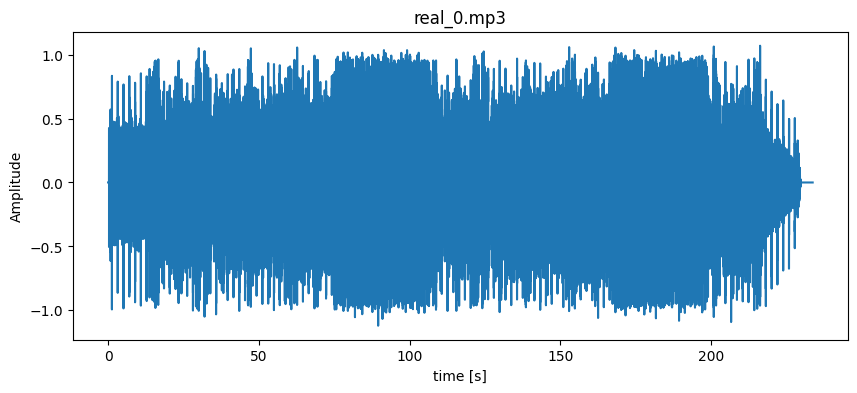

In [2]:
# Load signals
Fs = 22050

# f = fake_train[0][0]
# r = real_train[0][0]

f = librosa.load('sonics/train/fake/00088.mp3', sr=22050)[0]
r = librosa.load('sonics/train/real/real_00009.mp3', sr=22050)[0]

f_N = f.shape[0]
r_N = r.shape[0]

f_time_axis = np.arange(f_N) / Fs
r_time_axis = np.arange(r_N) / Fs

plt.figure(figsize=(10,4))
plt.plot(r_time_axis, r)
plt.title("real_0.mp3")
plt.xlabel("time [s]")
plt.ylabel("Amplitude")

ipd.Audio(r, rate=Fs)

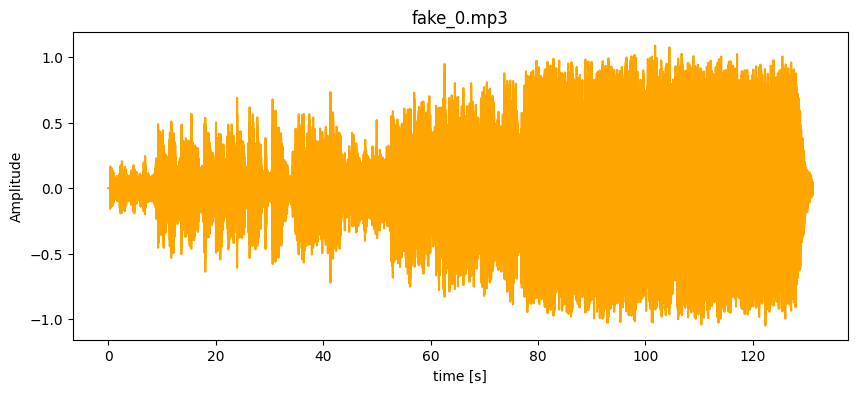

In [3]:
plt.figure(figsize=(10,4))
plt.plot(f_time_axis, f, color="orange")
plt.title("fake_0.mp3")
plt.xlabel("time [s]")
plt.ylabel("Amplitude")

ipd.Audio(f, rate=Fs)



Text(0.5, 1.0, 'fake_0 FFT')

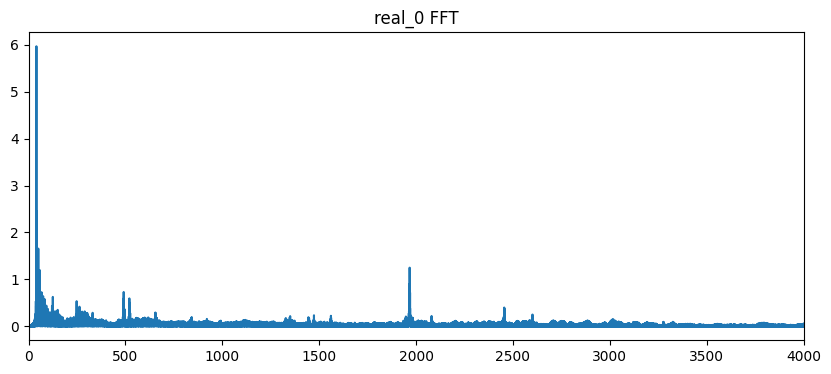

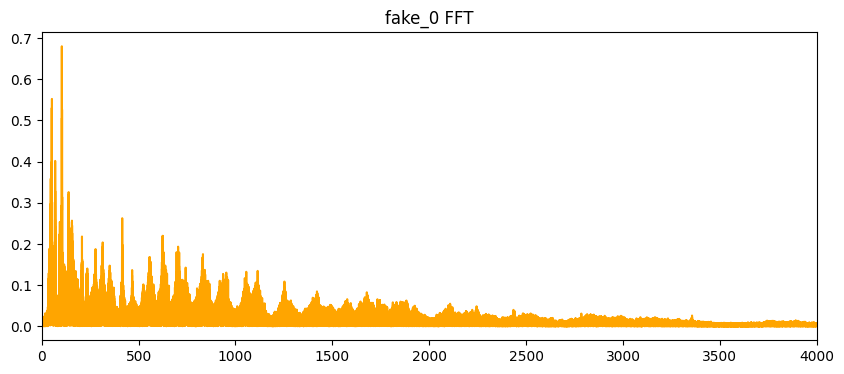

In [4]:
# FFT
R = np.abs(np.fft.fft(r)) /Fs #magnitude
r_freq_axis = np.fft.fftfreq(r_N, d=1/Fs)
R = R[:r_N//2]
r_freq_axis = r_freq_axis[:r_N//2]

plt.figure(figsize=(10,4))
plt.plot(r_freq_axis, R)
plt.xlim((0, 4000))
plt.title("real_0 FFT")


F = np.abs(np.fft.fft(f)) /Fs #magnitude
f_freq_axis = np.fft.fftfreq(f_N, d=1/Fs)
F = F[:f_N//2]
f_freq_axis = f_freq_axis[:f_N//2]

plt.figure(figsize=(10,4))
plt.plot(f_freq_axis, F, color="orange")
plt.xlim((0, 4000))
plt.title("fake_0 FFT")


In [5]:
def STFT(x, w, H):

    if np.array_equal(x, r):
        file = "real"
    elif np.array_equal(x, f):
        file = "fake"

    N = len(w)
    L = len(x)
    M = int(np.floor(L-N) / H)
    X = np.zeros((N, M + 1), dtype='complex')

    for m in range(M + 1):
        x_win = x[m * H: m * H + N] * w
        X_win = np.fft.fft(x_win)
        X[:, m] = X_win

    K = (N+1) // 2
    X = X[:K, :]

    X = np.abs(X) ** 2

    eps = np.finfo(float).eps

    X_dB = 10 * np.log10(X + eps)

    print(type(X))
    print(X.shape)


    #plot parameters
    x_time_axis = np.arange(X_dB.shape[1]) * H / Fs
    x_frequency_axis = np.arange(X_dB.shape[0]) * Fs / N

    left = min(x_time_axis)
    right = max(x_time_axis) + N / Fs
    lower = min(x_frequency_axis)
    upper = max(x_frequency_axis)

    #plot
    plt.figure(figsize=(10,4))
    img = plt.imshow(X_dB, origin='lower', aspect='auto', extent=[left, right, lower, upper], vmin = -20, vmax=30)
    plt.colorbar(img)
    plt.xlabel('Time (seconds)')
    plt.ylabel('Frequency (Hz)')
    plt.title(f'STFT {file}')
    plt.tight_layout()

    return X, X_dB

<class 'numpy.ndarray'>
(2048, 5030)
<class 'numpy.ndarray'>
(2048, 2820)


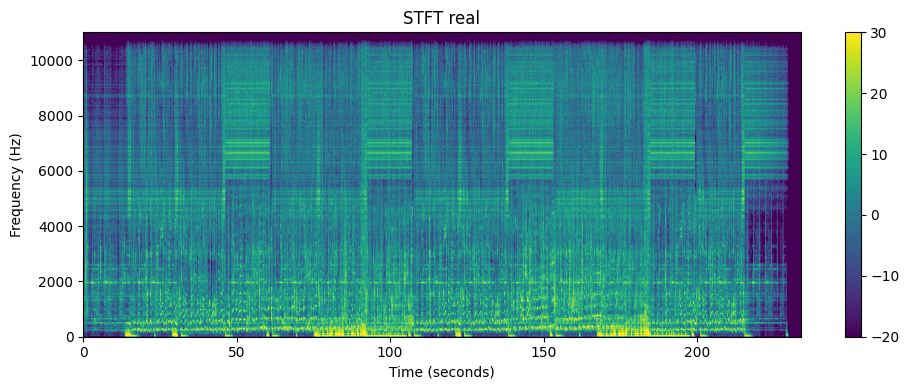

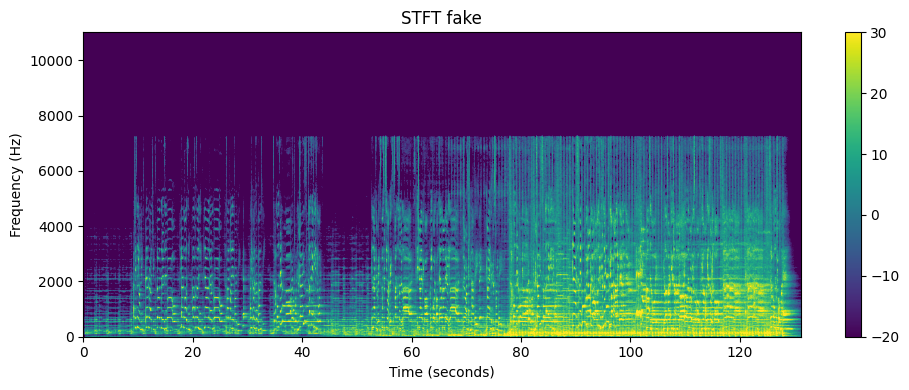

In [ ]:
#STFT

#user parameters
N = 4096
H = 1024 # H < N --> Overlapping 75% --> Good Time Resolution in a single

w = np.hanning(N)

R_stft, R_stft_dB = STFT(r, w, H)
F_stft, F_stft_dB = STFT(f, w, H)


## Question 2

In [36]:
from utils import lower_envelope, max_normalise, curve_profile

def fakeprint(stft, f_range = [0, 16000], fs = 22050):
    """
    Compute the fakeprint feature from an STFT representation.

        Args:
            stft: 2D STFT spectrogram.
            f_range: Frequency range [min_freq, max_freq] over which the
                     curve profile is computed.
            SR: Sampling rate of the original audio signal.

        Returns:
            fp_curve: Normalized fakeprint feature curve extracted from the
                      averaged spectral profile.
    """
    #Your first task is to reduce the stft matrix to a single spectral curve. 
    #You do this by computing the mean of the STFT across all time frames
    
    bins, frames = stft.shape
    mean_spectrum = np.zeros(bins)

    for bin in range(bins):
        mean_spectrum[bin] = np.mean(stft[bin, :])
    
    x_freq = np.linspace(0, fs/2, bin)
    mask = (x_freq > f_range[0]) & (x_freq < f_range[1])

    fp_curve = mean_spectrum[mask]
    x_freq = x_freq[mask]

    return fp_curve, x_freq

In [37]:
# Test fakeprint

fp_curve, x_freq = fakeprint(F_stft)

plt.figure(figsize=(10,4))
plt.plot(x_freq, fp_curve)
plt.xlim((x_freq[0], x_freq[-1]))



IndexError: boolean index did not match indexed array along dimension 0; dimension is 2048 but corresponding boolean dimension is 2047

## Question 3

In [ ]:
def compute_feature_vector(filename, Fs, N=4096, H=1024):
    """Compute the feature vector 

    Args:
        filename: Input filename
        Fs: Sampling rate
        N: Window length
        H: Hop size

    Returns:
        f_vector: Feature vector
    """
    
    
    return f_vector

In [ ]:
# Define labels_dict

# Compute feature vector - train

# Compute feature vector - test


In [ ]:
# Train regressor


In [ ]:
# Print the accuracy for the train set

# Plot the confusion matrix


## Question 4

In [ ]:
# Compute prediction for the test set

# Print tracks classified as 'real'
real_tracks = []
print('The real tracks are: \n')


In [ ]:
# Find password
psw = 0


print(f'The password is: {psw}')

In [ ]:
# Verify if your items are real



In [ ]:
# Print the accuracy for the test set

# Plot the confusion matrix

## Question 5

In [ ]:
# Find the key sentence
